In [1]:
#@title Default title text
!python --version

Python 3.9.4


In [2]:
# Only run this if you are in google colab

# %%bash
# git clone https://github.com/fengqingthu/CLIP_Steering.git
# git clone https://github.com/openai/CLIP.git

In [3]:
# # Only run this if you are in google colab
# %%bash

# pip install ninja 2>> install.log
# git clone https://github.com/SIDN-IAP/global-model-repr.git tutorial_code 2>> install.log

In [4]:
# Only run this if you are in google colab
# %%bash
# pip install torch==1.9.1+cu111 torchvision==0.10.1+cu111 torchaudio==0.9.1 -f https://download.pytorch.org/whl/torch_stable.html
# pip install \
#   pytorch-pretrained-biggan \
#   ftfy \
#   regex \
#   tqdm \
#   git+https://github.com/openai/CLIP.git \
#   click \
#   requests \
#   pyspng \
#   ninja \
#   imageio-ffmpeg==0.4.3 \
#   scipy

Looking in links: https://download.pytorch.org/whl/torch_stable.html
  Using cached Pillow-9.5.0-cp39-cp39-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (3.3 MB)
  Using cached numpy-1.24.3-cp39-cp39-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (17.3 MB)


You should consider upgrading via the '/home/ubuntu/biggan/.venv/bin/python3 -m pip install --upgrade pip' command.


  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-le6xpzcg
  Using cached ftfy-6.1.1-py3-none-any.whl (53 kB)
  Using cached tqdm-4.65.0-py3-none-any.whl (77 kB)
  Using cached requests-2.29.0-py3-none-any.whl (62 kB)
  Using cached urllib3-1.26.15-py2.py3-none-any.whl (140 kB)
  Using cached idna-3.4-py3-none-any.whl (61 kB)
  Using cached certifi-2022.12.7-py3-none-any.whl (155 kB)
  Using cached charset_normalizer-3.1.0-cp39-cp39-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (199 kB)
  Using cached s3transfer-0.6.0-py3-none-any.whl (79 kB)
  Using cached jmespath-1.0.1-py3-none-any.whl (20 kB)
Using legacy 'setup.py install' for clip, since package 'wheel' is not installed.
    Running setup.py install for clip: started
    Running setup.py install for clip: finished with status 'done'


You should consider upgrading via the '/home/ubuntu/biggan/.venv/bin/python3 -m pip install --upgrade pip' command.


In [1]:
# Leo: Changed this to work with the correct PyTorch version
import sys, torch

sys.path.append('/content/tutorial_code')
if not torch.cuda.is_available():
    print("Change runtime type to include a GPU.")

## Import all dependencies

Make sure to add CLIP_steering into the path so that we can use the GANAlyze tools.

In [2]:
import logging
import os
import pathlib
import sys

import clip
import IPython.display
import numpy as np
import torch
import torch.nn.functional as F
from PIL import Image
from pytorch_pretrained_biggan import (
    BigGAN,
    convert_to_images,
    one_hot_from_int,
    truncated_noise_sample,
)

sys.path.insert(0, "./CLIP_Steering")
sys.path.insert(0, "./tutorial_code")
try:
    import ganalyze_common_utils as common
    import ganalyze_transformations as transformations
except ImportError:
    print("Could not import ganalyze_common_utils or ganalyze_transformations")

# os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "MAX_SPLIT_SIZE_1=32MB"

logging.basicConfig(
    format="%(asctime)s %(levelname)-8s %(message)s",
    level=logging.INFO,
    datefmt="%Y-%m-%d %H:%M:%S",
)

logger = logging.getLogger(__name__)

# Declare helper functions

These functions are useful for showing and generating GAN images. We leverage a lot of the BigGAN functions like `one_hot_from_int` or `convert_to_images`.

In [3]:
#@title Helper functions

def show_images(images: list[Image.Image]):
    """Show a list of images in a row."""
    images = [np.array(img) for img in images]
    images = np.concatenate(images, axis=1)
    IPython.display.display(Image.fromarray(images))


def show_and_save_images(
    images: list[Image.Image], batch: int, path: str, variant: str = "original"
):
    show_images(images)

    if not os.path.exists(path):
        os.makedirs(path)

    for i, img in enumerate(images):
        img.save(f"{path}/image_{batch}_{i}_{variant}.png")


def make_noise_and_class_vectors(num_samples: int, truncation: float, class_id: int):
    noise_vector = truncated_noise_sample(truncation=truncation, batch_size=num_samples)
    class_vector = one_hot_from_int(class_id, batch_size=num_samples)

    # All in tensors
    noise_vector = torch.from_numpy(noise_vector)
    class_vector = torch.from_numpy(class_vector)

    # If you have a GPU, put everything on cuda
    noise_vector = noise_vector.to(device)
    class_vector = class_vector.to(device)

    return noise_vector, class_vector

def get_clip_probs(image_inputs, encoded_text, model, attribute_index=0):
    image_inputs = torch.stack([preprocess(img) for img in image_inputs]).to(device)
    image_feats = model.encode_image(image_inputs).float()
    image_feats = F.normalize(image_feats, p=2, dim=-1)

    clip_probs = (
        100.0 * torch.matmul(image_feats, torch.transpose(encoded_text, 0, 1))
    ).softmax(dim=-1)
    clip_probs = clip_probs.to(device)

    return clip_probs.narrow(dim=-1, start=attribute_index, length=1).squeeze(dim=-1)


def make_images_and_probs(
    model, z, y, truncation, clip_model, encoded_text, attribute_index=0
):
    gan_output = model(z, y, truncation)
    gan_output = gan_output.detach().cpu().numpy()
    gan_images = convert_to_images(gan_output)

    clip_probs = get_clip_probs(gan_images, encoded_text, clip_model, attribute_index)

    return gan_images, clip_probs

# Import and test BigGAN

Check that BigGAN works fine. We're using the `biggan-deep-256` version now, but there are alternatives.

In [4]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# G = BigGAN.from_pretrained('biggan-256')
G = BigGAN.from_pretrained("biggan-deep-256")
G.eval()
G.to(device)

# Verify/ visualize sample from BigGan following the example at:
# https://github.com/huggingface/pytorch-pretrained-BigGAN

# Prepare a input
truncation = 0.4
CLIP_CLASS_ID = 232
noise_vector, class_vector = make_noise_and_class_vectors(
    num_samples=1, truncation=truncation, class_id=CLIP_CLASS_ID
)

# Generate an image
with torch.no_grad():
    output = G(noise_vector, class_vector, truncation)

output = output.detach().cpu().numpy()
output.shape

2023-05-05 17:53:00 INFO     loading model biggan-deep-256 from cache at /home/ubuntu/.pytorch_pretrained_biggan/e7d036ee69a83e83503c46902552573b27d856eaf6b8b84252a63a715dce7501.aec5caf3e5c5252b8857d6bb8adefa8d1d6092a8ba6c9aaed1e6678f8a46be43
2023-05-05 17:53:00 INFO     Model config {
  "attention_layer_position": 8,
  "channel_width": 128,
  "class_embed_dim": 128,
  "eps": 0.0001,
  "layers": [
    [
      false,
      16,
      16
    ],
    [
      true,
      16,
      16
    ],
    [
      false,
      16,
      16
    ],
    [
      true,
      16,
      8
    ],
    [
      false,
      8,
      8
    ],
    [
      true,
      8,
      8
    ],
    [
      false,
      8,
      8
    ],
    [
      true,
      8,
      4
    ],
    [
      false,
      4,
      4
    ],
    [
      true,
      4,
      2
    ],
    [
      false,
      2,
      2
    ],
    [
      true,
      2,
      1
    ]
  ],
  "n_stats": 51,
  "num_classes": 1000,
  "output_dim": 256,
  "z_dim": 128
}


(1, 3, 256, 256)

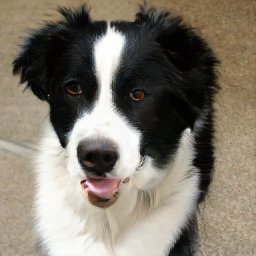

In [ ]:
output_images = convert_to_images(output)
show_images(output_images)

# GAN Dissection

Our mission: look inside a GAN generator to see what it does.

We begin with some imports and jupyter setup.

In [5]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib as mpl

In [6]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Running pytorch', torch.__version__, 'using', device.type)

Running pytorch 1.9.1+cu111 using cuda


## Instantiating a pretrained GAN generator.

We're going to use a progressive GAN.

Below I download and instantiate a model for outdoor churches.

You can uncomment the model of your choice.

After we create the model, I just print out all the layers.

In [35]:
import torchvision
import torch.hub
from netdissect import nethook

model = G
model

BigGAN(
  (embeddings): Linear(in_features=1000, out_features=128, bias=False)
  (generator): Generator(
    (gen_z): Linear(in_features=256, out_features=32768, bias=True)
    (layers): ModuleList(
      (0): GenBlock(
        (bn_0): BigGANBatchNorm(
          (scale): Linear(in_features=256, out_features=2048, bias=False)
          (offset): Linear(in_features=256, out_features=2048, bias=False)
        )
        (conv_0): Conv2d(2048, 512, kernel_size=(1, 1), stride=(1, 1))
        (bn_1): BigGANBatchNorm(
          (scale): Linear(in_features=256, out_features=512, bias=False)
          (offset): Linear(in_features=256, out_features=512, bias=False)
        )
        (conv_1): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (bn_2): BigGANBatchNorm(
          (scale): Linear(in_features=256, out_features=512, bias=False)
          (offset): Linear(in_features=256, out_features=512, bias=False)
        )
        (conv_2): Conv2d(512, 512, kernel_size=(3, 

# Exercise 1 - Directly inspect the internal representation

In this exercise we just run the code provided and scrutinize the activations directly.

## Running the model.

The GAN generator is just a function z->x that transforms random z to realistic images x.

To generate images, all we need is a source of random z.  Let's make a micro dataset with a few random z.

In [38]:
l = [m for m in model.generator.layers.named_modules()]
l

[('',
  ModuleList(
    (0): GenBlock(
      (bn_0): BigGANBatchNorm(
        (scale): Linear(in_features=256, out_features=2048, bias=False)
        (offset): Linear(in_features=256, out_features=2048, bias=False)
      )
      (conv_0): Conv2d(2048, 512, kernel_size=(1, 1), stride=(1, 1))
      (bn_1): BigGANBatchNorm(
        (scale): Linear(in_features=256, out_features=512, bias=False)
        (offset): Linear(in_features=256, out_features=512, bias=False)
      )
      (conv_1): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn_2): BigGANBatchNorm(
        (scale): Linear(in_features=256, out_features=512, bias=False)
        (offset): Linear(in_features=256, out_features=512, bias=False)
      )
      (conv_2): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn_3): BigGANBatchNorm(
        (scale): Linear(in_features=256, out_features=512, bias=False)
        (offset): Linear(in_features=256, out_features=512, bias=False)
  

In [7]:
from netdissect import zdataset

SAMPLE_SIZE = 20 # Increase this for better results (but slower to run)
# zds = zdataset.z_dataset_for_model(model, size=SAMPLE_SIZE, seed=5555)
# len(zds), zds[0][0].shape

truncation = 0.4
noise_vector, class_vector = make_noise_and_class_vectors(
    num_samples=SAMPLE_SIZE, truncation=truncation, class_id=CLIP_CLASS_ID
)

We can just invoke model(z[None,...]) to generate a single image.

In [9]:
# Look at the output data - print a few pixel values
# model(zds[0][0][None,...].to(device), )[0,0,:10]

# Generate an image
with torch.no_grad():
    output = model(noise_vector, class_vector, truncation)

output = output.detach().cpu().numpy()
output.shape

(20, 3, 256, 256)

## Visualizing the output.

The netdissect toolkit comes with a few simple visualization tools for examining images in notebooks.

  * renormalize turns tensors that were normalized as [-1...1] back into PIL images.
  * show takes nested arrays of images and text and lays then out as grids and tables.
  
Let's look at the images we created with our model.

In [16]:
from netdissect import renormalize, show

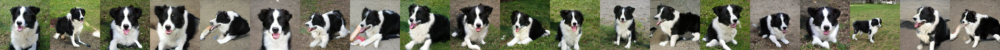

In [10]:
from netdissect import renormalize, show

output_images = convert_to_images(output)
show_images(output_images)


In [ ]:
!nvidia-smi

Fri Apr 21 20:39:36 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   54C    P0    37W /  70W |  10475MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Hooking a model with InstrumentedModel

To analyze what a model is doing inside, we can wrap it with an InstrumentedModel, which makes it easy to hook or modify a particular layer.

InstrumentedModel adds a few useful functions for inspecting a model, including:
   * `model.retain_layer('layername')` - hooks a layer to hold on to its output after computation
   * `model.retained_layer('layername')` - returns the retained data from the last computation
   * `model.edit_layer('layername', rule=...)` - runs the `rule` function after the given layer
   * `model.remove_edits()` - removes editing rules

Let's setup `retain_layer` now.  We'll pick a layer sort of in the early-middle of the generator.  You can pick whatever you like.

In [44]:
# TODO: add a summary of what InstrumentedModel can do.
# retain a layer, get a retined layer, edit a layer

from netdissect import nethook

# Don't re-wrap it, if it's already wrapped (e.g., if you press enter twice)
if not isinstance(model, nethook.InstrumentedModel):
    model = nethook.InstrumentedModel(model)
model.retain_layer('generator.layers.6')

Now we can run the model and inspect the internal units.

In [45]:
# Run the model
# img = model(zds[0][0][None,...].to(device))
with torch.no_grad():
    img = model(noise_vector, class_vector, truncation)

# img = img.detach().cpu().numpy()
img.shape


# As a side-effect, the model has retained the output of layer4.
acts = model.retained_layer('generator.layers.6')

# We can look at it.  How much data is it?
acts.shape

torch.Size([20, 1024, 32, 32])

In [41]:
# Let's just look at the 0th convolutional channel.
print(acts[0,0])


tensor([[ 0.2387,  0.2061,  0.2352,  ...,  0.3692,  0.2836,  0.3118],
        [ 0.4618,  0.4211,  0.4938,  ...,  0.4241,  0.1776,  0.6160],
        [ 0.5575,  0.4471,  0.5979,  ...,  0.2454,  0.0779,  0.6406],
        ...,
        [ 0.3271,  0.3442,  0.5964,  ...,  0.2070, -0.1239,  0.3076],
        [ 0.3249,  0.2834,  0.3868,  ..., -0.0899, -0.3048,  0.1099],
        [ 0.7736,  0.8734,  0.9093,  ...,  0.3956,  0.2932,  0.3821]],
       device='cuda:0')


## Visualizing activation data

It can be informative to visualize activation data instead of just looking at the numbers.

Net dissection comes with an ImageVisualizer object for visualizing grid data as an image in a few different ways.  Here is a heatmap of the array above:

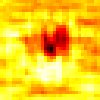

In [46]:
from netdissect import imgviz
iv = imgviz.ImageVisualizer(100)
iv.heatmap(acts[0,1], mode='nearest')

If you tell IV to dereference the activations for you, it scales heatmaps according to global statistics.

What is happening with unit 418?

Each unit has a different scale, which makes the heatmaps harder to interpret.

We can normalize the scales by collecting stats.


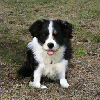
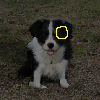
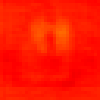
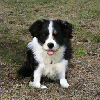
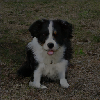
...
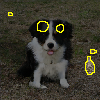
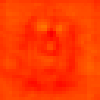
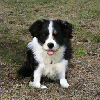
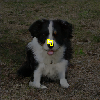
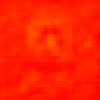

In [47]:
show(
    [['unit %d' % u,
      [iv.image(img[0])],
      [iv.masked_image(img[0], acts, (0,u))],
      [iv.heatmap(acts, (0,u), mode='nearest')],
     ] for u in range(440, 460)]  
)

## Collecting quantile statistics for every unit

We want to know per-channel minimum or maximum values, means, medians, quantiles, etc.

We want to treat each pixel as its own sample for all the channels.  For example, here are the activations for one image as an 8x8 tensor over with 512 channels.  We can disregard the geometry and just look at it as a 64x512 sample matrix, that is 64 samples of 512-dimensional vectors.

In [48]:
torch.cuda.empty_cache()

In [49]:
print(acts.shape)
print(acts.permute(0, 2, 3, 1).contiguous().view(-1, acts.shape[1]).shape)

torch.Size([20, 1024, 32, 32])
torch.Size([20480, 1024])


Net dissection has a tally package that tracks quantiles over large samples.

To use it, just define a function that returns sample matrices like the 64x512 above, and then it will call your function on every batch and tally up the statistics.

In [11]:
CLIP_CLASS_ID = 232


@torch.no_grad()
def run_model_batch(zbatch):
    zclass = one_hot_from_int(CLIP_CLASS_ID, batch_size=len(zbatch))
    zclass = torch.from_numpy(zclass)
    zclass = zclass.to(zbatch.device)

    output = model(zbatch, zclass, truncation)

    zclass.detach().cpu()
    torch.cuda.empty_cache()

    return output

In [50]:
from netdissect import tally

# To collect stats, define a function that returns 2d [samples, units]
def compute_samples(zbatch):
    # _ = model(zbatch.to(device))          # run the model
    run_model_batch(zbatch)
    acts = model.retained_layer('generator.layers.6') # get the activations, and flatten
    return acts.permute(0, 2, 3, 1).contiguous().view(-1, acts.shape[1])

# Then tally_quantile will run your function over the whole dataset to collect quantile stats
rq = tally.tally_quantile(compute_samples, noise_vector)

# Print out the median value for the first 20 channels
rq.quantiles(0.5)[:20]

  0%|          | 0/2 [00:00<?, ?it/s]

tensor([ 0.1691,  0.0048, -0.7909, -0.0093,  0.2723, -0.5170, -0.0953, -0.0035,
        -0.1252, -0.5920, -0.1258,  0.0505, -0.0119,  0.0375,  0.6366,  0.3561,
        -0.1866,  0.4805, -0.0366, -0.0950])

In [ ]:
!nvidia-smi

Fri Apr 21 20:39:39 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   55C    P0    37W /  70W |   1893MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
torch.tensor(3).dtype

torch.int64

## Exploring quantiles

The rq object tracks a sketch of all the quantiles of the sampled data.  For example, what is the mean, median, and percentile value for each unit?

In [51]:
# This tells me now, for example, what the means are for channel,
# rq.mean()
# what median is,
# rq.quantiles(0.5)
# Or what the 99th percentile quantile is.
# rq.quantiles(0.99)

(rq.quantiles(0.8) > 0).sum()

tensor(798)

The quantiles can be plugged directly into the ImageVisualizer to put heatmaps on an informative per-unit scale.  When you do this:

   * Heatmaps are shown on a scale from black to white from 1% lowest to the 99% highest value.
   * Masked image lassos are shown at a 95% percentile level (by default, can be changed).
   
Now unit 418 doesn't drown out the other ones in the visualization.


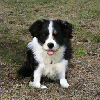
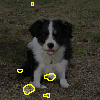
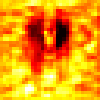
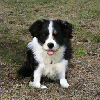
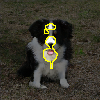
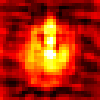
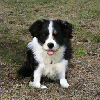
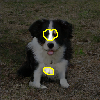
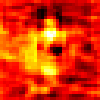

In [52]:
iv = imgviz.ImageVisualizer(100, quantiles=rq)
show([
    [  # for every unit, make a block containing
       'unit %d' % u,         # the unit number
       [iv.image(img[0])],    # the unmodified image
       [iv.masked_image(img[0], acts, (0,u))], # the masked image
       [iv.heatmap(acts, (0,u), mode='nearest')], # the heatmap
    ]
    for u in range(530, 533)
])

## Visualizing top-activating images

A useful way to visualize units is to sort a sample, in order of highest activation.  tally_topk does this.

Like torch.topk, it returns both the top k values and the top k indexes.  But instead of acting on a single tensor, it iterates over the whole data set.

In [53]:
!nvidia-smi

Fri May  5 19:58:35 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.47.03    Driver Version: 510.47.03    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            On   | 00000000:00:1E.0 Off |                    0 |
| N/A   38C    P0    33W /  70W |   6092MiB / 15360MiB |     14%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [54]:
def compute_image_max(zbatch):
    run_model_batch(zbatch)
    return model.retained_layer('generator.layers.6').max(3)[0].max(2)[0]

topk = tally.tally_topk(compute_image_max, noise_vector)
topk.result()[1].shape

  0%|          | 0/2 [00:00<?, ?it/s]

torch.Size([1024, 20])


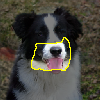
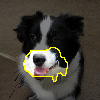
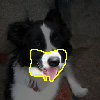
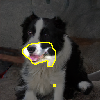
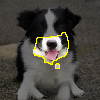
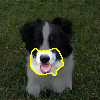
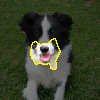
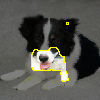

In [55]:
# For each unit, this function prints out unit masks from the top-activating images
def unit_viz_row(unitnum, percent_level=0.95):
    out = []
    for imgnum in topk.result()[1][unitnum][:8]:
        # img = model(zds[imgnum][0][None,...].to(device))
        with torch.no_grad():
            img = model(noise_vector, class_vector, truncation)
        acts = model.retained_layer('generator.layers.6')
        out.append([imgnum.item(),
                    [iv.masked_image(img[imgnum.item()], acts[imgnum.item()].unsqueeze(0), (0, unitnum), percent_level=percent_level)],
                   ])
    return out

show(unit_viz_row(25))

In [21]:
!nvidia-smi

Fri May  5 18:32:58 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.47.03    Driver Version: 510.47.03    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            On   | 00000000:00:1E.0 Off |                    0 |
| N/A   41C    P0    69W /  70W |  14076MiB / 15360MiB |     38%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Exercise 2 - Evaluate matches with semantic concepts

Do the filters match any semantic concepts?  To systematically examine this question,
we have pretrained (using lots of labeled data) a semantic segmentation network to recognize
a few hundred classes of objects, parts, and textures.

Run the code in this section to look for matches between filters in our GAN and semantic
segmentation clases.

## Labeling semantics within the generated images

Let's quantify what's inside these images by segmenting them.

First, we create a segmenter network.  (We use the Unified Perceptual Parsing segmenter by Xiao, et al. (https://arxiv.org/abs/1807.10221).

Note that the segmenter we use here requires a GPU.

If you have a CPU only, you can skip to step "Examining units that select for trees" below.

In [12]:
from netdissect import segmenter, setting

# segmodel = segmenter.UnifiedParsingSegmenter(segsizes=[256])
segmodel, seglabels, _ = setting.load_segmenter('netpq')
# seglabels = [l for l, c in segmodel.get_label_and_category_names()[0]]
print('segmenter has', len(seglabels), 'labels')

segmenter has 1813 labels


Then we create segmentation images for the dataset.  Here tally_cat just concatenates batches of image (or segmentation) data.

  * `segmodel.segment_batch` segments an image
  * `iv.segmentation(seg)` creates a solid-color visualization of a segmentation
  * `iv.segment_key(seg, segmodel)` makes a small legend for the segmentation

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

,
,grass
,dog
,ground
,
,grass
,dog
,
,grass
,dog
,

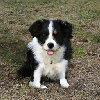
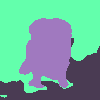
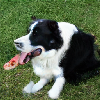
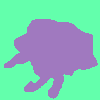
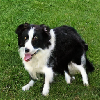
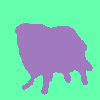
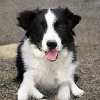
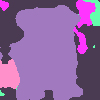
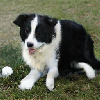
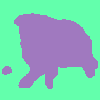

In [56]:
from netdissect import upsample
from netdissect import segviz

imgs = tally.tally_cat(run_model_batch, noise_vector)
seg = tally.tally_cat(lambda img: segmodel.segment_batch(img.cuda(), downsample=1), imgs)

from netdissect.segviz import seg_as_image, segment_key
show([
    (iv.image(imgs[i]),
     iv.segmentation(seg[i,0]),
     iv.segment_key(seg[i,0], segmodel)
    )
    for i in range(min(len(seg), 5))
])

In [ ]:
!nvidia-smi

Fri Apr 21 20:40:25 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   62C    P0    39W /  70W |   9479MiB / 15360MiB |      2%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Identifying units that correlate with visual concepts

Some units align well with visual concepts.

To identify these, we will collect *conditional* activation statistics.

In addition to regular quantile statistics, we will collect quantile statistics over all the subsets of pixels in which a particular visual concept is present.

To do this, we will use the `tally_conditional_quantile` loop.

It expects its `compute` function to return a list of sample statistics, each one keyed by a condition that is present.

Here is how we do it.

In [57]:
torch.cuda.empty_cache()
!nvidia-smi

Fri May  5 20:01:42 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.47.03    Driver Version: 510.47.03    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            On   | 00000000:00:1E.0 Off |                    0 |
| N/A   44C    P0    41W /  70W |   6412MiB / 15360MiB |     55%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [58]:
# We upsample activations to measure them at each segmentation location.
upfn8 = upsample.upsampler((64, 64), (8, 8)) # layer4 is resolution 8x8


def compute_conditional_samples(zbatch):
    zclass = one_hot_from_int(CLIP_CLASS_ID, batch_size=len(zbatch))
    zclass = torch.from_numpy(zclass)
    zclass = zclass.to(zbatch.device)

    image_batch = model(zbatch, zclass, truncation)
    zclass.detach().cpu()

    seg = segmodel.segment_batch(image_batch, downsample=4)
    upsampled_acts = upfn8(model.retained_layer('generator.layers.6'))

    samples = tally.conditional_samples(upsampled_acts, seg)

    torch.cuda.empty_cache()
    return samples

# Run this function once to sample one image
sample = compute_conditional_samples(noise_vector[:1])

# The result is a list of all the conditional subsamples
[(seglabels[c], d.shape) for c, d in sample]

[('-', torch.Size([4096, 1024])),
 ('grass', torch.Size([2006, 1024])),
 ('ground', torch.Size([974, 1024])),
 ('dog', torch.Size([1116, 1024])),
 ('grass-t', torch.Size([1453, 1024])),
 ('ground-t', torch.Size([228, 1024])),
 ('dog-t', torch.Size([555, 1024])),
 ('grass-l', torch.Size([1156, 1024])),
 ('ground-l', torch.Size([292, 1024])),
 ('dog-l', torch.Size([489, 1024])),
 ('grass-b', torch.Size([547, 1024])),
 ('ground-b', torch.Size([746, 1024])),
 ('dog-b', torch.Size([561, 1024])),
 ('grass-r', torch.Size([844, 1024])),
 ('ground-r', torch.Size([682, 1024])),
 ('dog-r', torch.Size([627, 1024])),
 ('carpet', torch.Size([1027, 1024])),
 ('fabric', torch.Size([1, 1024])),
 ('foliage', torch.Size([792, 1024])),
 ('food', torch.Size([7, 1024])),
 ('fur', torch.Size([2048, 1024])),
 ('polished stone', torch.Size([9, 1024])),
 ('skin', torch.Size([1, 1024])),
 ('tile', torch.Size([200, 1024])),
 ('wood', torch.Size([11, 1024])),
 ('leg', torch.Size([166, 1024])),
 ('head', torch.Size

In [59]:
cq = tally.tally_conditional_quantile(compute_conditional_samples, noise_vector)

  0%|          | 0/20 [00:00<?, ?it/s]

Conditional quantile statistics let us compute lots of relationships between units and visual concepts.

For example, IoU is the "intersection over union" ratio, measuring how much overlap there is between the top few percent activations of a unit and the presence of a visual concept.  We can estimate the IoU ratio for all pairs between units and concepts with these stats:

In [60]:
iou_table = tally.iou_from_conditional_quantile(cq, cutoff=0.99)
iou_table.shape

torch.Size([1024, 1778])

Now let's view a few of the units, labeled with an associated concept, sorted from highest to lowest IoU.

unit 543: nose (iou 0.30)



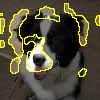
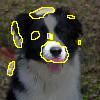
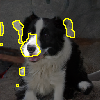
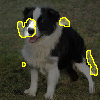
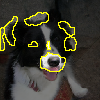
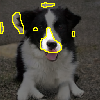
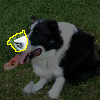
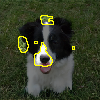

unit 916: nose (iou 0.30)



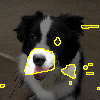
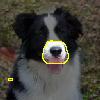
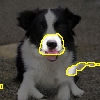
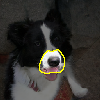
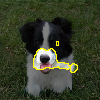
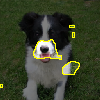
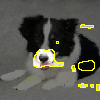
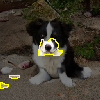

unit 780: nose (iou 0.30)



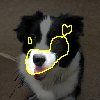
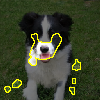
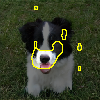
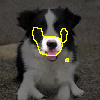
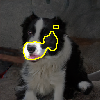
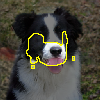
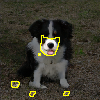
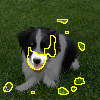

unit 934: nose (iou 0.29)



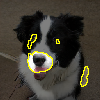
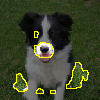
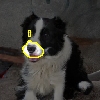
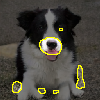
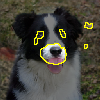
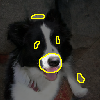
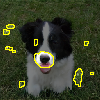
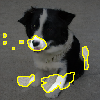

unit 359: nose (iou 0.29)



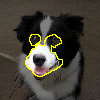
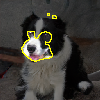
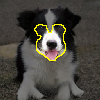
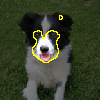
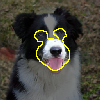
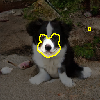
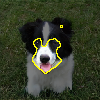
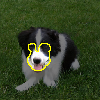

In [61]:
unit_list = sorted(enumerate(zip(*iou_table.max(1))), key=lambda k: -k[1][0])

for unit, (iou, segc) in unit_list[:5]:
    print('unit %d: %s (iou %.2f)' % (unit, seglabels[segc], iou))
    show(unit_viz_row(unit))

We can quantify the overall match between units and segmentation concepts by counting the number of units that match a segmentation concept (omitting low-scoring matches).

In [62]:
print('Number of units total:', len(unit_list))
print('Number of units that match a segmentation concept with IoU > 0.04:',
   len([i for i in range(len(unit_list)) if unit_list[i][1][0] > 0.04]))

Number of units total: 1024
Number of units that match a segmentation concept with IoU > 0.04: 870


## Examining units that select for nose

Now let's filter just units that were labeled as 'nose' units.

In [63]:
nose_index = seglabels.index('nose')
nose_units = [(unit, iou) for iou, unit in
              list(zip(*(iou_table[:,nose_index].sort(descending=True))))[:10]]
# If you can't run the segmenter, uncomment the line below and comment the one above.
# nose_units = [(torch.tensor(312), torch.tensor(0.2508)),
#  (torch.tensor(540), torch.tensor(0.2247)),
#  (torch.tensor(963), torch.tensor(0.2242)),
#  (torch.tensor(334), torch.tensor(0.2159)),
#  (torch.tensor(426), torch.tensor(0.2145)),
#  (torch.tensor(911), torch.tensor(0.2097)),
#  (torch.tensor(863), torch.tensor(0.2077)),
#  (torch.tensor(340), torch.tensor(0.2017)),
#  (torch.tensor(945), torch.tensor(0.1973)),
#  (torch.tensor(172), torch.tensor(0.1969))]

unit 543, iou 0.30



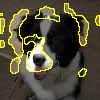
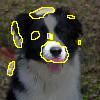
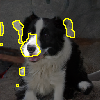
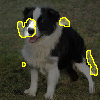
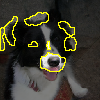
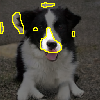
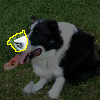
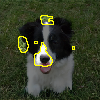

unit 916, iou 0.30



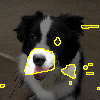
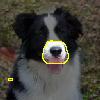
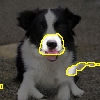
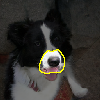
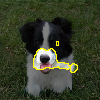
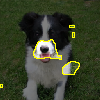
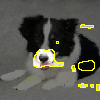
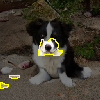

unit 780, iou 0.30



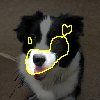
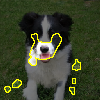
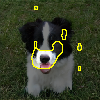
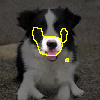
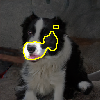
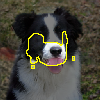
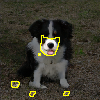
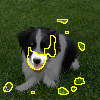

unit 934, iou 0.29



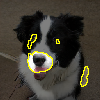
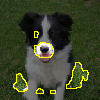
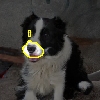
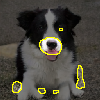
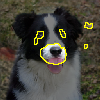
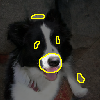
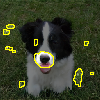
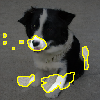

unit 359, iou 0.29



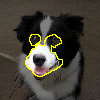
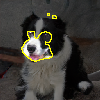
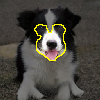
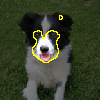
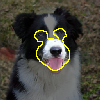
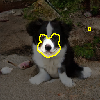
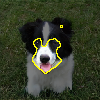
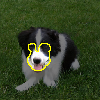

unit 861, iou 0.29



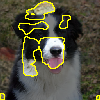
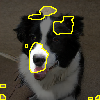
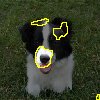
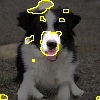
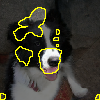
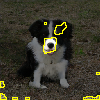
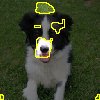
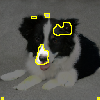

unit 545, iou 0.28



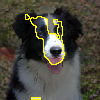
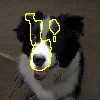
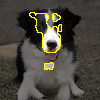
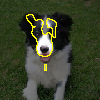
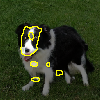
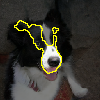
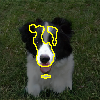
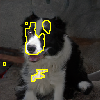

unit 743, iou 0.28



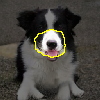
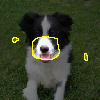
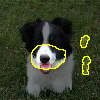
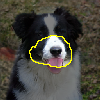
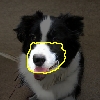
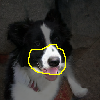
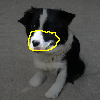
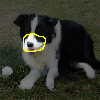

unit 941, iou 0.27



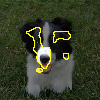
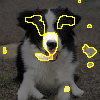
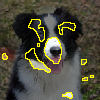
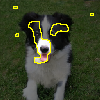
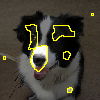
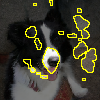
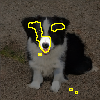
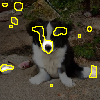

unit 1007, iou 0.26



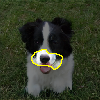
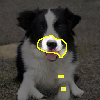
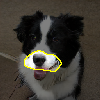
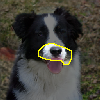
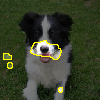
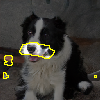
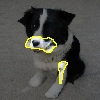
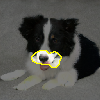

In [64]:
for unit, iou in nose_units:
    print('unit %d, iou %.2f' % (unit, iou))
    show(unit_viz_row(unit))

## Editing a model by altering units

Now let's try changing some units directly to see what they do.

We we will use `model.edit_layer` to do that.

This works by just allowing you to define a function that edits the output of a layer.

We will edit the output of `layer12` by zeroing ten of the tree units.

In [65]:
# Leo: Changed here how the nose units are used as indexes
nose_units_ix = [ix for ix, _ in nose_units]
nose_units_ix

[tensor(543),
 tensor(916),
 tensor(780),
 tensor(934),
 tensor(359),
 tensor(861),
 tensor(545),
 tensor(743),
 tensor(941),
 tensor(1007)]

In [66]:
!nvidia-smi

Fri May  5 20:24:02 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.47.03    Driver Version: 510.47.03    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            On   | 00000000:00:1E.0 Off |                    0 |
| N/A   58C    P0    38W /  70W |  13968MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

  0%|          | 0/2 [00:00<?, ?it/s]

Before,After
Before,After
Before,After
Before,After
Before,After
Before,After
Before,After
Before,After
Before,After
Before,After

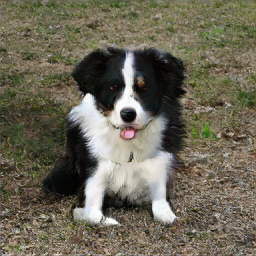
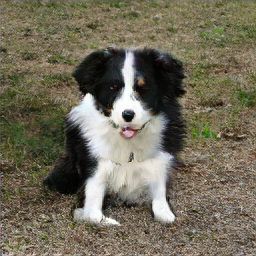
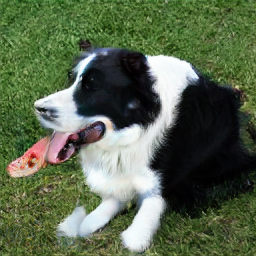
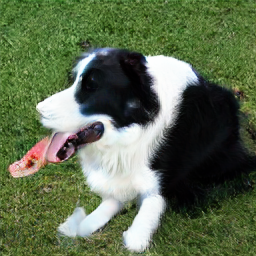
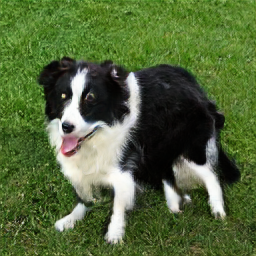
...
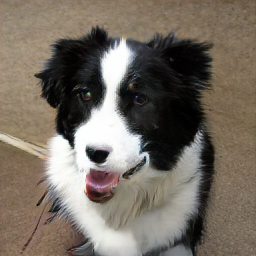
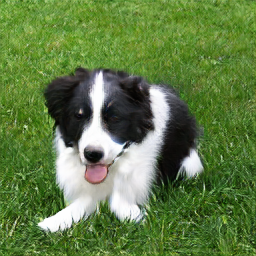
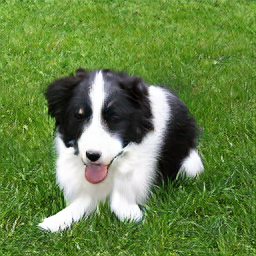
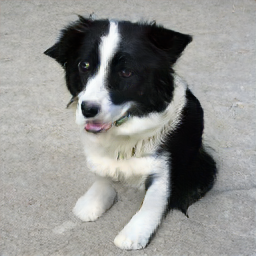
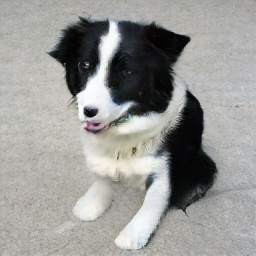

In [67]:
def zero_out_nose_units(data, model):
    data[:, nose_units_ix, :, :] = 0.0
    return data
    
model.edit_layer('generator.layers.6', rule=zero_out_nose_units)
edited_imgs = tally.tally_cat(run_model_batch, noise_vector)

show([
    (['Before', [renormalize.as_image(imgs[i])]],
     ['After', [renormalize.as_image(edited_imgs[i])]])
      for i in range(min(10, len(noise_vector)))])
model.remove_edits()

# Exercise 3 - Testing causal effects of representation units

Now it's your turn.

Now try the following experiments:
   * Instead of zeroing the tree units, try setting them negative, e.g., to -5.
   * Instead of turning the tree units off, try turning them on, e.g., set them to 10.


  0%|          | 0/2 [00:00<?, ?it/s]

Before,After
Before,After
Before,After
Before,After
Before,After
Before,After
Before,After
Before,After
Before,After
Before,After

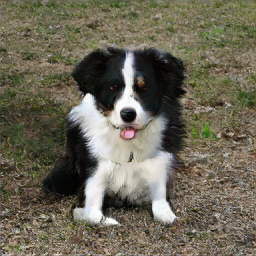
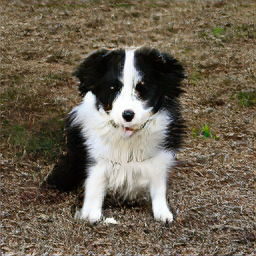
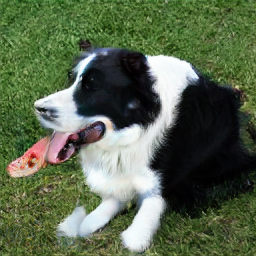
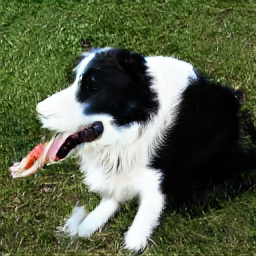
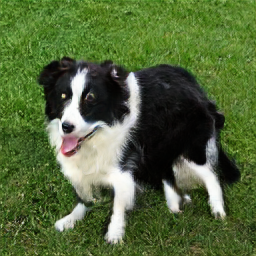
...
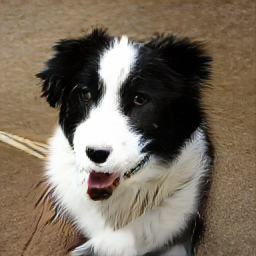
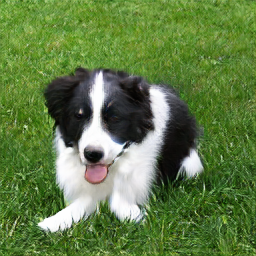
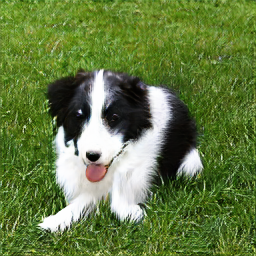
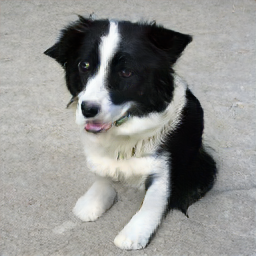
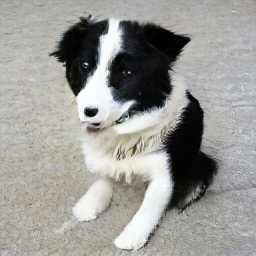

In [68]:
# Your solution to exercise 3.

def zero_out_nose_units(data, model):
    data[:, nose_units_ix, :, :] = -5
    return data

model.edit_layer('generator.layers.6', rule=zero_out_nose_units)
edited_imgs = tally.tally_cat(run_model_batch, noise_vector)

show([
    (['Before', [renormalize.as_image(imgs[i])]],
     ['After', [renormalize.as_image(edited_imgs[i])]])
      for i in range(min(10, len(noise_vector)))])
model.remove_edits()


# Exercise 4 - Examining units for other concepts


Find a set of `door`-selective units `door_units` (instead of `tree_units`), or choose another concepts such as `grass` or `dome`.

Then create a set of examples show the effect of setting the these off, to `-5.0` or on, at `10.0`.

What is the effect on doors?  What is the effect on other types of objects in the generated scenes?

  0%|          | 0/2 [00:00<?, ?it/s]

Before,After
Before,After
Before,After
Before,After
Before,After
Before,After
Before,After
Before,After
Before,After
Before,After

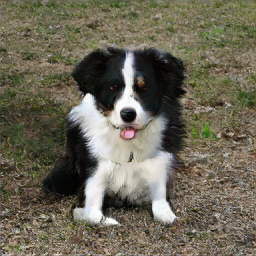
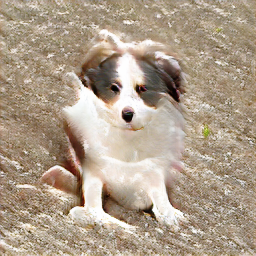
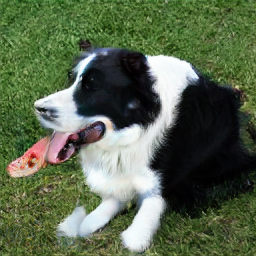
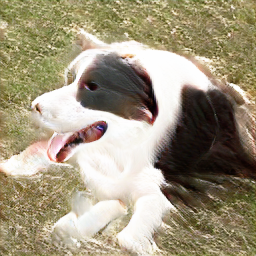
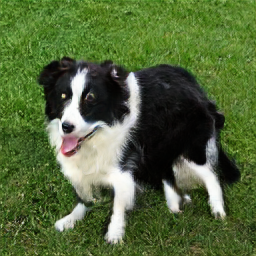
...
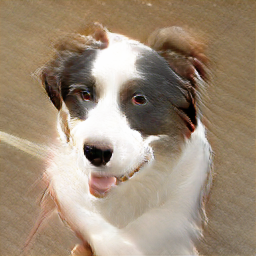
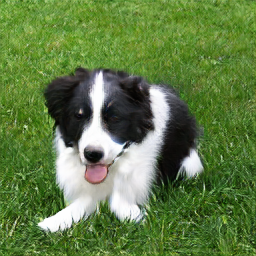
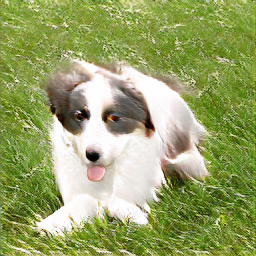
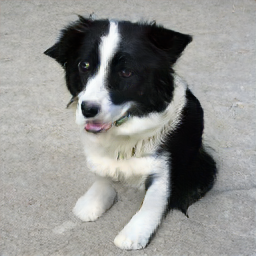
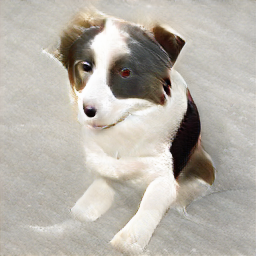

In [69]:
# Your solution to exercise 4.

ear_index = seglabels.index('ear')
ear_units = [(unit, iou) for iou, unit in
              list(zip(*(iou_table[:,ear_index].sort(descending=True))))[:10]]
ear_units_ix = [ix for ix, _ in ear_units]

def turn_off_ear_units(data, model):
    data[:, ear_units_ix, :, :] = -5.0
    return data

# Then visualize the effect
model.edit_layer('generator.layers.6', rule=turn_off_ear_units)
edited_imgs = tally.tally_cat(run_model_batch, noise_vector)

show([
    (['Before', [renormalize.as_image(imgs[i])]],
     ['After', [renormalize.as_image(edited_imgs[i])]])
      for i in range(min(10, len(noise_vector)))])
model.remove_edits()

# Exercise 5 - Comparing layers

Collect and visualize the maximum activating images for each unit in `layer5` or `layer6`.

Count units that match segmented concepts with IoU > 0.04 in your layer.

Are there more matching units than `layer4`, or fewer?

Hints:

* Skeleton visualization code is below.
* To examine the representation at layer5, you will need to `model.retain_layer('layer5')`
* layer5 has resolution 16x16 and needs a new upfn function to upsample from that resolution. layer2 is 4x4.
* Get conditional quantiles using `tally_conditional_quantile` with a compute_conditional_samples written for layer5.
* Then use `iou_from_conditional_quantile` to count matches between units and concepts.



In [ ]:
# Starter code for exercise 5

model.retain_layer('generator.layers.5')

# Visualizations of units at layer5 can be done like this
def compute_image_max5(zbatch):
    run_model_batch(zbatch)
    return model.retained_layer('generator.layers.5').max(3)[0].max(2)[0]

# Find the top-activating images for each unit
topk5 = tally.tally_topk(compute_image_max5, noise_vector)

# Build a visualization for each unit
def unit_viz_row5(unitnum, percent_level=0.95):
    # Build an array of iv.masked_image for each unitnum,
    # Using the top-activating image indexes in topk5
    out = []
    for imgnum in topk5.result()[1][unitnum][:8]:
        # run the model on zds[imgnum]
        # collect the retained activations from layer5
        # add a masked image (iv.masked_image) to the array
        out.append([]) # add your code
    return out

# Show a few units
for unit in range(20):
    show(unit_viz_row5(unit))


In [ ]:
# Your solution for exercise 5

upfn16 = upsample.upsampler((64, 64), (16, 16)) # layer5 is resolution 16x16

def compute_layer5_conditional_samples(zbatch):
    zclass = one_hot_from_int(CLIP_CLASS_ID, batch_size=len(zbatch))
    zclass = torch.from_numpy(zclass)
    zclass = zclass.to(zbatch.device)

    image_batch = model(zbatch, zclass, truncation)
    zclass.detach().cpu()

    seg = segmodel.segment_batch(image_batch, downsample=4)
    upsampled_acts = upfn8(model.retained_layer('generator.layers.5'))

    samples = tally.conditional_samples(upsampled_acts, seg)

    torch.cuda.empty_cache()
    return samples


cq5 = tally.tally_conditional_quantile(compute_layer5_conditional_samples, noise_vector)
iou_table5 = tally.iou_from_conditional_quantile(cq, cutoff=0.99)

In [ ]:
unit_list5 = sorted(enumerate(zip(*iou_table5.max(1))), key=lambda k: -k[1][0])
print('Number of units matching concepts better than IoU 0.04:', len(unit_list5))

Number of units matching concepts better than IoU 0.04: 1024


Special thanks to Lucy Chai, Àgata Lapedriza, and Katherine Gallagher for testing this notebook.

# Steering BigGAN

We will train a model for steering the noise vector which is the input of BigGAN. This model will transform the noise vector into a vector which has a better score with the text "A portrait of a dog" in the CLIP model. 

## Load the CLIP model and explore it

In [70]:
clip_model, preprocess = clip.load("ViT-B/32", device=device)
clip_model.eval()
clip_model.to(device)

image = preprocess(Image.open("CLIP/CLIP.png")).unsqueeze(0).to(device)
text = clip.tokenize(["a diagram", "a dog", "a cat"]).to(device)

with torch.no_grad():
    image_features = clip_model.encode_image(image)
    text_features = clip_model.encode_text(text)

    logits_per_image, logits_per_text = clip_model(image, text)
    probs = logits_per_image.softmax(dim=-1).cpu().numpy()

print("Label probs:", probs)  # prints: [[0.9927937  0.00421068 0.00299572]]

Label probs: [[0.9927   0.004253 0.003016]]


In [71]:
torch.cuda.empty_cache()
latent_space_dim = (
    G.config.z_dim
)  # I added this manually from info at: https://github.com/huggingface/pytorch-pretrained-BigGAN/blob/master/README.md
context_length = clip_model.context_length
vocab_size = clip_model.vocab_size

print(
    "Model parameters:",
    f"{np.sum([int(np.prod(p.shape)) for p in clip_model.parameters()]):,}",
)
print("Context length:", context_length)
print("Vocab size:", vocab_size)
print("Latent space dimension:", latent_space_dim)

Model parameters: 151,277,313
Context length: 77
Vocab size: 49408
Latent space dimension: 128


In [72]:
# Extract text features for clip

# Here is how we specify the desired attributes
attributes = ["a portrait of a dog"]
attribute_index = 0  # which attribute do we want to maximize
text_descriptions = [f"Photo of {label}" for label in attributes]


with torch.no_grad():
    text_tokens = clip.tokenize(text_descriptions).to(device)
    text_features = clip_model.encode_text(text_tokens).float()
    text_features = F.normalize(text_features, p=2, dim=-1)

text_features.shape

torch.Size([1, 512])

## Load the transformation model and train it

In [73]:
transformation = transformations.OneDirection(latent_space_dim, vocab_size)
transformation = transformation.to(device)


approach:  one_direction



[Maximizing score for a portrait of a dog] Progress: [0/4500] Loss 0.078891 (0.078891)
saving checkpoint at iteration 0


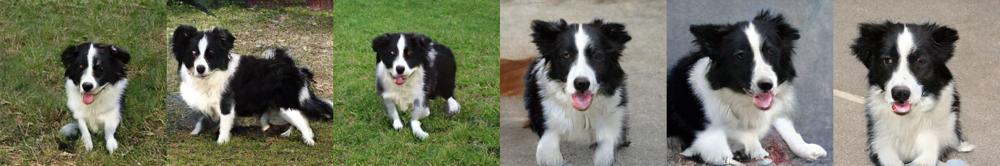

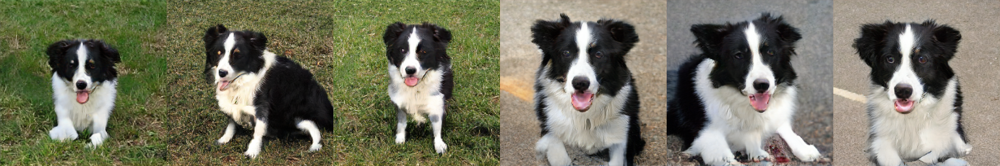

KeyboardInterrupt: ignored

In [ ]:
optimizer = torch.optim.Adam(
    transformation.parameters(), lr=0.0002
)  # as specified in GANalyze
losses = common.AverageMeter(name="Loss")

#  training settings
optim_iter = 0
batch_size = 6  # Do not change
train_alpha_a = -0.5  # Lower limit for step sizes
train_alpha_b = 0.5  # Upper limit for step sizes
#
# Number of samples to train for # Ganalyze uses 400,000 samples.
# Use smaller number for testing.
#
num_samples = 4500

# Specify the parameters to create the noise and vector classes
truncation = 0.4
class_id = 232

# CHANGE. How to initialize noise and class vectors
noise_vector, class_vector = make_noise_and_class_vectors(
    num_samples, truncation, class_id=class_id
)

attribute_index = 0
checkpoint_dir = f"checkpoints/results_maximize_{attributes[attribute_index]}_probability"
pathlib.Path(checkpoint_dir).mkdir(parents=True, exist_ok=True)

# loop over data batches
for batch_start in range(0, num_samples, batch_size):
    #
    # Setup the batch z and y vectors. Also sample step sizes.
    #
    s = slice(batch_start, min(num_samples, batch_start + batch_size))

    z = noise_vector[s]
    y = class_vector[s]

    step_sizes = (train_alpha_b - train_alpha_a) * np.random.random(
        size=(batch_size)
    ) + train_alpha_a  # sample step_sizes

    step_sizes_broadcast = np.repeat(step_sizes, latent_space_dim).reshape(
        [batch_size, latent_space_dim]
    )
    step_sizes_broadcast = (
        torch.from_numpy(step_sizes_broadcast).type(torch.FloatTensor).to(device)
    )

    #
    # Generate the original images and get their clip scores
    #
    gan_images, out_scores = make_images_and_probs(
        model=G,
        z=z,
        y=y,
        truncation=truncation,
        clip_model=clip_model,
        encoded_text=text_features,
        attribute_index=attribute_index,
    )

    # TODO: ignore z vectors with less confident clip scores
    target_scores = out_scores + torch.from_numpy(step_sizes).to(device).float()

    #
    # Transform the z vector and get the clip scores for the transformed images
    #
    z_transformed = transformation.transform(z, y, step_sizes_broadcast)
    gan_images_transformed, out_scores_transformed = make_images_and_probs(
        model=G,
        z=z_transformed,
        y=y,
        truncation=truncation,
        clip_model=clip_model,
        encoded_text=text_features,
        attribute_index=attribute_index,
    )

    #
    # Compute loss and backpropagate
    #
    loss = transformation.criterion(out_scores_transformed, target_scores)

    loss.backward()
    optimizer.step()

    #
    # Print and save intermediate results
    #
    losses.update(loss.item(), batch_size)
    if optim_iter % 10 == 0:
        logger.info(
            f"[Maximizing score for {attributes[attribute_index]}] "
            f"Progress: [{batch_start}/{num_samples}] {losses}"
        )
        print(
            f"[Maximizing score for {attributes[attribute_index]}] "
            f"Progress: [{batch_start}/{num_samples}] {losses}"
        )

    if optim_iter % 50 == 0:
        logger.info(f"saving checkpoint at iteration {optim_iter}")
        print(f"saving checkpoint at iteration {optim_iter}")
        torch.save(
            transformation.state_dict(),
            os.path.join(checkpoint_dir, "pytorch_model_{}.pth".format(batch_start)),
        )

        # plot and save sample images
        show_and_save_images(gan_images, batch_start, checkpoint_dir)
        show_and_save_images(
            gan_images_transformed, batch_start, checkpoint_dir, "transformed"
        )

    optim_iter = optim_iter + 1

torch.save(
    transformation.state_dict(),
    os.path.join(checkpoint_dir, "pytorch_model_final.pth"),
)

In [75]:
batch_size = 6  # Do not change
alpha = 0.1
num_samples = 6
class_id = 232

truncation = 0.4
noise_vector, class_vector = make_noise_and_class_vectors(
    num_samples, truncation, class_id=class_id
)

attribute_index = 0
iters = 5

transformation = transformations.OneDirection(latent_space_dim, vocab_size)
# transformation.load_state_dict(
#     torch.load(
#         os.path.join(checkpoint_dir, "pytorch_model_final.pth"),
#     ),
#     strict=True,
# )
# # If you already trained the model, you can introducce the weights to the transformation model
# from google.colab import drive
# drive.mount('/content/drive')
# transformation.load_state_dict(torch.load("/content/drive/MyDrive/Sabrina <> Leo/Weights/Big GAN/pytorch_model_portaitofadog_final.pth"))

transformation.load_state_dict(torch.load("/home/ubuntu/biggan/pytorch_model_portraitofadog.pth"))
transformation.to(device)
transformation.eval()

# %%

with torch.no_grad():
    for batch_start in range(0, num_samples, batch_size):
        #
        # Setup the batch z and y vectors. Also sample step sizes.
        #
        s = slice(batch_start, min(num_samples, batch_start + batch_size))

        z = noise_vector[s]
        y = class_vector[s]

        step_sizes = (
            (torch.ones((batch_size, latent_space_dim)) * alpha).float().to(device)
        )

        # Transform the z vector in the positive direction
        positive_outputs = []
        transformed_noise = z.clone()

        for iter in range(iters):
            transformed_noise = transformation.transform(transformed_noise, y, step_sizes)


approach:  one_direction



## Compare the GAN dissect with BigGAN and steered BigGAN

Now we've got the transformed noise, which we can use it to create images with the BigGAN.

First, let's compare the **highest activations** in the fourth layer using the transformed noise to the ones using the original noise vector.

  0%|          | 0/1 [00:00<?, ?it/s]


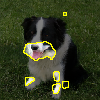
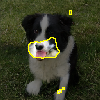
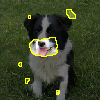
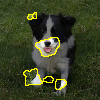
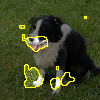
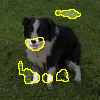

In [76]:
def unit_viz_row_2(unitnum, vector,topk,percent_level=0.95):
    out = []
    for imgnum in topk.result()[1][unitnum][:8]:
        with torch.no_grad():
            img = model(vector, class_vector, truncation)
        acts = model.retained_layer('generator.layers.6')
        out.append([imgnum.item(),
                    [iv.masked_image(img[imgnum.item()], acts[imgnum.item()].unsqueeze(0), (0, unitnum), percent_level=percent_level)],
                   ])
    return out

topk_transformed = tally.tally_topk(compute_image_max, transformed_noise)

show(unit_viz_row_2(25, transformed_noise, topk_transformed))

Let's compare with the highest activations in the same layer, when we use the original noise vector.
The five highest activations are in the same units, but in different order. 

  0%|          | 0/1 [00:00<?, ?it/s]


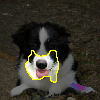
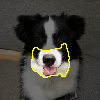
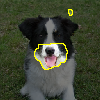
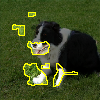
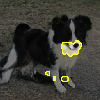
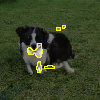

In [77]:
topk_original = tally.tally_topk(compute_image_max, noise_vector)

show(unit_viz_row_2(25, noise_vector, topk_original))

Now, let's compare the activations which match with the IoU in dog pictures of the two vectors

In [78]:
cq_transformed = tally.tally_conditional_quantile(compute_conditional_samples, transformed_noise)

iou_table_transformed = tally.iou_from_conditional_quantile(cq_transformed, cutoff=0.99)

unit_list_transformed = sorted(enumerate(zip(*iou_table_transformed.max(1))), key=lambda k: -k[1][0])

print('Number of units total:', len(unit_list_transformed))
print('Number of units that match a segmentation concept with IoU > 0.04:',
   len([i for i in range(len(unit_list_transformed)) if unit_list_transformed[i][1][0] > 0.04]))

  0%|          | 0/6 [00:00<?, ?it/s]

Number of units total: 1024
Number of units that match a segmentation concept with IoU > 0.04: 816


The number of units that match a segmentation concept with IoU > 0.04 is smaller than the same metric with the original noise

In [79]:
nose_index_transformed = seglabels.index('nose')
nose_units_transformed = [(unit, iou) for iou, unit in
              list(zip(*(iou_table_transformed[:,nose_index_transformed].sort(descending=True))))[:10]]

print('Number of nose units total:', len(nose_units_transformed))
print('Number of nose units that match a segmentation concept with IoU > 0.25:',
   len([i for i in range(len(nose_units_transformed)) if nose_units_transformed[i][1] > 0.18]))

Number of nose units total: 10
Number of nose units that match a segmentation concept with IoU > 0.25: 10


The number of nose units that match a segmentation concept with IoU > 0.04 is also smaller than the same metric with the original noise

In [80]:
print('Number of nose units total:', len(nose_units))
print('Number of nose units that match a segmentation concept with IoU > 0.25:',
   len([i for i in range(len(nose_units)) if nose_units[i][1] > 0.18]))

Number of nose units total: 10
Number of nose units that match a segmentation concept with IoU > 0.25: 10
